In [1]:
# imports
from netCDF4 import Dataset as NetCDFFile

# for projections manipulation
import cartopy
import cartopy.crs as ccrs

import numpy as np
import numpy.ma as ma
import pandas as pd

# plotting libraries
import matplotlib.pyplot as plt
import plotly.graph_objects as go

In [2]:
geography_file = NetCDFFile("GRACEDADM_CLSM0125US_7D.A20210809.030.nc4")

In [3]:
k = 1
# unpack data into variables
lat = geography_file['lat'][::k]
lon = geography_file['lon'][::k]

gws = geography_file['gws_inst'][0, ::k, ::k]
rtzsm = geography_file['rtzsm_inst'][0, ::k, ::k]
sfsm = geography_file['sfsm_inst'][0, ::k, ::k]

# create a meshgrid for plotting
Lat, Lon = np.meshgrid(lat, lon)

# put into dataframe. plotly likes dataframes
data = pd.DataFrame(np.c_[Lat.T.flatten(), Lon.T.flatten(), gws.flatten()], columns=['Lat', 'Lon', 'gws'])

C:\Users\Sophie\anaconda3\lib\site-packages\ipykernel_launcher.py:3: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\Sophie\anaconda3\lib\site-packages\ipykernel_launcher.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  after removing the cwd from sys.path.
C:

# 2D plots

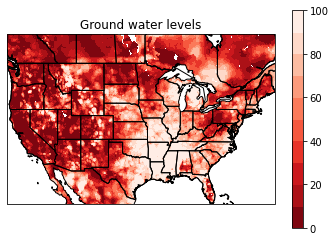

In [4]:
# end map projection is specified here
ax = plt.axes(projection=ccrs.Mercator(central_longitude=-100))

# the matplotlib contour function does not require meshgrids, it works with 1D lists for coordinates
im = ax.contourf(lon, lat, gws, 10, cmap='Reds_r', transform=ccrs.PlateCarree())
plt.colorbar(im)

# ax.coastlines()
ax.add_feature(cartopy.feature.COASTLINE)
ax.add_feature(cartopy.feature.STATES)
ax.add_feature(cartopy.feature.BORDERS)

plt.title('Ground water levels')
plt.show()

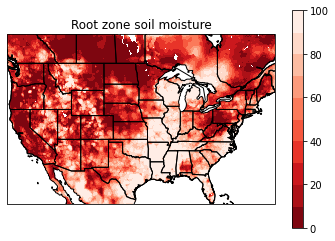

In [5]:
# end map projection is specified here
ax = plt.axes(projection=ccrs.Mercator(central_longitude=-100))

# the matplotlib contour function does not require meshgrids, it works with 1D lists for coordinates
im = ax.contourf(lon, lat, rtzsm, 10, cmap='Reds_r', transform=ccrs.PlateCarree())
plt.colorbar(im)

ax.add_feature(cartopy.feature.COASTLINE)
ax.add_feature(cartopy.feature.STATES)
ax.add_feature(cartopy.feature.BORDERS)

plt.title('Root zone soil moisture')
plt.show()

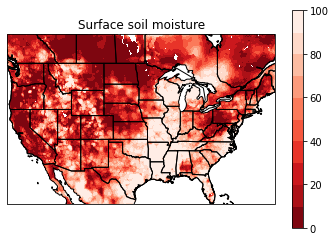

In [6]:
# end map projection is specified here
ax = plt.axes(projection=ccrs.Mercator(central_longitude=-100))

# the matplotlib contour function does not require meshgrids, it works with 1D lists for coordinates
im = ax.contourf(lon, lat, rtzsm, 10, cmap='Reds_r', transform=ccrs.PlateCarree())
plt.colorbar(im)

ax.add_feature(cartopy.feature.COASTLINE)
ax.add_feature(cartopy.feature.STATES)
ax.add_feature(cartopy.feature.BORDERS)

plt.title('Surface soil moisture')
plt.show()

# 3D plot

In [7]:
# first we read the state boundaries data
from cartopy.io import shapereader
from cartopy.mpl.patch import geos_to_path
import geopandas

# get natural earth data (http://www.naturalearthdata.com/)

# get borders
resolution = '110m'
category = 'cultural'
name = 'admin_1_states_provinces'

shpfilename = shapereader.natural_earth(resolution, category, name)

# read the shapefile using geopandas
df = geopandas.read_file(shpfilename)

# remove Hawaii and Alaska
df = df[~((df['name'] == 'Alaska') | (df['name'] == 'Hawaii'))]

In [8]:
# here we are using the meshgrids (notice "Lon", not "lon")
# in order to display different levels we simply subtract a fixed value from all z coordinates of a layer
# since we do not use special map projections here (or, to be me more precise, we use the equidistant cyllindrical projection),
# we have a situation where the height of surfaces peak are too big compared to the scale of map
# so we scale down the height manually
gws_scale, rtzsm_scale, sfsm_scale = 20, 20, 20
rtzsm_shift, sfsm_shift = 20, 40

fig = go.Figure(data=[go.Surface(x=Lon, y=Lat, z=gws.filled(0).T / gws_scale,
                                 name='Ground water levels', colorscale='Greens', showscale=False),
                      go.Surface(x=Lon, y=Lat, z=rtzsm.T.filled(0) / rtzsm_scale - rtzsm_shift,
                                 name='Root zone soil moisture', colorscale='Reds', showscale=False),
                      go.Surface(x=Lon, y=Lat, z=sfsm.T.filled(0) / sfsm_scale - sfsm_shift,
                                 name='Surface soil moisture', colorscale='Blues', showscale=False)])

# now we add all states to the plot one by one
for poly in df['geometry']:
    # get the geometry object, convert it to path object
    path = geos_to_path(poly)[0]
    # now obtain x and y coordinates from the path object
    xs, ys = path.to_polygons()[0].T
    # this is how how high the borders will be shown
    # we will display them slighly higher than the corresponding map layer
    # for better visibility
    zs = np.zeros_like(xs) + 2
    fig.add_scatter3d(
        x=xs,
        y=ys,
        z=zs,
        mode='lines',
        name='',
        showlegend=False,
        line=dict(width=5, color='black')
    )
    
    # same, but for root zone moisture
    path = geos_to_path(poly)[0]
    xs, ys = path.to_polygons()[0].T
    zs = np.zeros_like(xs) + 2 - rtzsm_shift
    fig.add_scatter3d(
        x=xs,
        y=ys,
        z=zs,
        mode='lines',
        name='',
        showlegend=False,
        line=dict(width=5, color='black')
    )
    
    # same, but for surface soil moisture
    path = geos_to_path(poly)[0]
    xs, ys = path.to_polygons()[0].T
    zs = np.zeros_like(xs) + 2 - sfsm_shift
    fig.add_scatter3d(
        x=xs,
        y=ys,
        z=zs,
        mode='lines',
        name='',
        showlegend=False,
        line=dict(width=5, color='black')
    )

fig.update_layout(title='USA map of ground waters', autosize=False,
                  width=500, height=500,
                  margin=dict(l=0, r=0, b=0, t=50), 
                  scene=dict(aspectmode='data',
                             xaxis=dict(title=dict(text='Lon'), autorange='reversed'),
                             yaxis=dict(title=dict(text='Lat'), autorange='reversed'),
                             zaxis=dict(title=dict(text='')),
                            ),
)

fig.show()

In [12]:
def change(var_in):
    var_in[0] = 'Changed'

variable = ['Original']
change(variable)      
print(variable[0])

Changed
